In [1]:
import os

from datetime import datetime
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
print(tf.__version__)

2025-05-16 16:37:03.623097: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-16 16:37:03.631388: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747406223.640773   23227 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747406223.643683   23227 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-05-16 16:37:03.653800: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

2.18.0


In [2]:
# Input files
INPUT_DIR = "./DATA/PROCESSED"
INPUT_FILE_ADDITIONAL_PREPEND = ""
INPUT_FILE_DATA_PKL = 'POT_47N_2.5W_' + INPUT_FILE_ADDITIONAL_PREPEND + 'full_dataframe.pkl'
INPUT_FILE_OUTLIERS_PKL = 'POT_47N_2.5W_' + INPUT_FILE_ADDITIONAL_PREPEND + '95q_outliers_df.pkl'
INPUT_FILE_TRAIN_TS = 'POT_47N_2.5W_' + INPUT_FILE_ADDITIONAL_PREPEND + 'np_train_data.npz'

## Load data to pandas DataFrame

- Use pandas to store data as DataFrame object
- Drop time column because Kmeans requires only numeric data

In [3]:
df_wo_nan = pd.read_pickle(os.path.join(INPUT_DIR, INPUT_FILE_DATA_PKL))
outliers_dataframe = pd.read_pickle(os.path.join(INPUT_DIR, INPUT_FILE_OUTLIERS_PKL))
train_data = np.load(os.path.join(INPUT_DIR, INPUT_FILE_TRAIN_TS), allow_pickle=True)
print(f"Full dataset contains {df_wo_nan.shape[0]} observation points")
print(f"Outliers dataset contains {outliers_dataframe.shape[0]} observation points")
print(f"Train dataset contains {train_data['train_data'].shape} values")
print(f"Windows dataset contains {train_data['windows'].shape} values")
print(f"Timeseries dataset contains {train_data['timeseries'].shape} values")

Full dataset contains 727560 observation points
Outliers dataset contains 1237 observation points
Train dataset contains (1237, 216, 4) values
Windows dataset contains (1237, 2) values
Timeseries dataset contains (1237,) values


In [4]:
# PLOT DISTRIBUTION OF VARIABLES
outliers_dataframe.shape

(1237,)

In [5]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaled_df = df_wo_nan.copy(deep=True)
VARIABLES_TO_KEEP = ['swh', 'msl', 'ws', 'pp1d']
scaled_df = scaled_df[['date', *VARIABLES_TO_KEEP]]
scaled_df[VARIABLES_TO_KEEP] = scaler.fit_transform(scaled_df[VARIABLES_TO_KEEP])

print(scaled_df.head(5))

                 date       swh       msl        ws      pp1d
0 1940-01-01 00:00:00  0.180163  0.649288  0.307151  0.602304
1 1940-01-01 01:00:00  0.182821  0.647956  0.310196  0.601517
2 1940-01-01 02:00:00  0.185607  0.648337  0.309045  0.600144
3 1940-01-01 03:00:00  0.188956  0.647888  0.314788  0.598259
4 1940-01-01 04:00:00  0.193007  0.649641  0.320571  0.595932


Longest timeseries is 216 hours long. Its index is 786
Shortest timeseries is 8 hours long. Its index is 1030
Median duration is 48.0 hours long.


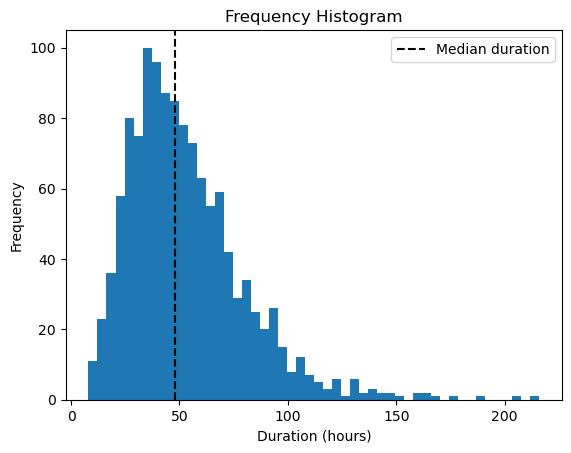

In [6]:
timeseries = train_data['timeseries'].tolist()
raw_timeseries = train_data['raw_timeseries'].tolist()
windows = train_data['windows']
full_train_data = train_data['train_data'] # Careful that variables to keep are in right order

ts_length = [len(ts) for ts in timeseries]
max_length = max(ts_length)
first_max = next(filter(lambda ts: len(ts) >= max_length, timeseries), None)
max_idx = next((i for i, val in enumerate(timeseries) if np.array_equal(val,first_max)), -1)
first_min = next(filter(lambda ts: len(ts) == np.min(ts_length), timeseries), None)
min_idx = next((i for i, val in enumerate(timeseries) if np.array_equal(val,first_min)), -1)
print(f"Longest timeseries is {np.max(ts_length)} hours long. Its index is {max_idx}")
print(f"Shortest timeseries is {np.min(ts_length)} hours long. Its index is {min_idx}")
print(f"Median duration is {np.median(ts_length)} hours long.")
plt.hist(ts_length, bins=50)
plt.axvline(np.median(ts_length), color="black", ls="--", label="Median duration")
plt.gca().set(title='Frequency Histogram', ylabel='Frequency', xlabel='Duration (hours)')
plt.legend()
plt.savefig('FIGS/TS_duration_histogram.pdf', dpi=600)

## Auto-encoder architecture with features extractor

- Same encoder architecture will be useed to extract features from univariate series in parallel
- Ouput of parallel encoders are stacked before decoder is applied

### Train and test sets creation

In [7]:
# read data 
perc_of_train_used = 20     # 5, 10, 20, 100    
valid_perc = 0.1
N, T, FEAT_DIM = full_train_data.shape
print('data shape:', N, T)
print(f"Warning, time dimension {T} should be divisible by 8: {T%8 == 0}")

data shape: 1237 216
Warning, time dimension 216 should be divisible by 8: True


In [8]:
# further split the training data into train and validation set - same thing done in forecasting task
N_train = int(N * (1 - valid_perc))
N_valid = N - N_train

# Shuffle data as a brand new numpy array (original array order should be preserved)
shuffle_data = np.array(full_train_data)
np.random.shuffle(shuffle_data) # shuffles in place

train_data = shuffle_data[:N_train]
valid_data = shuffle_data[N_train:]
print("train/valid shapes: ", train_data.shape, valid_data.shape)
SEQ_LEN = T

train/valid shapes:  (1113, 216, 4) (124, 216, 4)


### Custom loss function

Having timeseries of different lengths implies using padding/masking.

Mask is broadcasted through the model layers, but the loss is based on output/input data comparison

Thus, we have to deal with a custom loss function that takes the mask into account *AND* averages the absolute error based on the real number of observation measures

See following links for more details on mask propagation in TF/Keras:
- https://stackoverflow.com/questions/47057361/how-do-i-mask-a-loss-function-in-keras-with-the-tensorflow-backend
- https://www.tensorflow.org/guide/keras/understanding_masking_and_padding

In [9]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import keras as ks

In [10]:
def custom_mae_mask_loss(mask_value):
    mask_value = keras.backend.variable(mask_value)
    mae_loss = keras.losses.MeanAbsoluteError()
    def internal_loss(y_true, y_pred):        
        # find out which timesteps in `y_true` are not the padding value '0'
        mask = keras.backend.all(keras.backend.equal(y_true, mask_value), axis=-1)
        mask = 1 - keras.backend.cast(mask, keras.backend.floatx())
        # multiply mean absolute error with the mask
        loss = mae_loss(y_true, y_pred) * mask
        # Divide the computed loss by the actual number of unmasked values
        return keras.backend.sum(loss) / keras.backend.sum(mask)
    return internal_loss

def custom_mse_mask_loss(mask_value):
    mask_value = keras.backend.variable(mask_value)
    def internal_loss(y_true, y_pred):        
        # find out which timesteps in `y_true` are not the padding value '0'
        mask = keras.backend.all(keras.backend.equal(y_true, mask_value), axis=-1)
        mask = 1 - keras.backend.cast(mask, keras.backend.floatx())
        # multiply mean squared error with the mask
        loss = keras.losses.MeanSquaredError(y_true, y_pred) * mask
        
        return keras.backend.sum(loss) / keras.backend.sum(mask)
    return internal_loss

In [11]:
def convolution(blockInput, num_filters=16, kernel_size=3, dim_name=0, pool=False):
    """
    Defines convolution block that operates the addition of:
      - 1 convolution without relu
      - sequence of 2 convolutions with relu activation
    """
    xi = layers.Conv1D(num_filters, kernel_size=kernel_size, activation=None, padding="same")(blockInput)
    xi = layers.BatchNormalization()(xi)
    # Compute double convolution with relu
    xj = layers.Conv1D(num_filters, kernel_size=kernel_size, padding="same", activation="relu")(blockInput)
    xj = layers.Conv1D(num_filters, kernel_size=kernel_size, padding="same", activation="relu")(xj)
    
    x = layers.Add()([xj, xi])
    p = layers.MaxPool1D(2)(x)
    return p

def t_convolution(blockInput, num_filters=16, kernel_size=3, pool=False, up=True):
    """
    Defines deconvolution block that operates the addition of:
    - 1 convolution without relu
    - sequence of 2 convolutions with relu activation
    """
    xi = layers.Conv1DTranspose(num_filters, kernel_size=kernel_size, activation=None, padding="same")(blockInput)
    xi = layers.BatchNormalization()(xi)
    # Compute double deconvolution with relu
    xj = layers.Conv1DTranspose(num_filters, kernel_size=kernel_size, padding="same", activation="relu")(blockInput)
    xj = layers.Conv1DTranspose(num_filters, kernel_size=kernel_size, padding="same", activation="relu")(xj)
      
    x = layers.Add()([xj, xi])
    if up:
        x = layers.UpSampling1D(2)(x)
    return x

@ks.saving.register_keras_serializable()
class AutoEncoder(keras.Model):
  def __init__(self, num_filters, *args, **kwargs):
    super(AutoEncoder, self).__init__(*args, **kwargs)

    self.num_filters = num_filters
    self.encoder_input = layers.Input(shape=(SEQ_LEN, FEAT_DIM), name="encoder_input")
    # Split input multivariate timeseries into univariate ones
    encoded_features = []
    for i in range(FEAT_DIM):
        univ_inputs = self.encoder_input[:,:,i:i+1]
        x = convolution(univ_inputs, num_filters=self.num_filters, dim_name=i)
        x = convolution(x, num_filters=self.num_filters, dim_name=i)
        x = convolution(x, num_filters=self.num_filters, dim_name=i)
        x = layers.MaxPool1D(3)(x)
        # stack features to a list
        encoded_features.append(x)
    # Concat tensors to latent space
    self.tensor_encoded_features = layers.Concatenate()([t for t in encoded_features])
    self.encoder = keras.Model(inputs=self.encoder_input, outputs=self.tensor_encoded_features, name="encoder")

    y = layers.UpSampling1D(3)(self.tensor_encoded_features)
    y = layers.UpSampling1D(2)(y)
    y = t_convolution(y, num_filters=self.num_filters*FEAT_DIM)
    y = t_convolution(y, num_filters=self.num_filters*FEAT_DIM)
    y = layers.Conv1DTranspose(FEAT_DIM, kernel_size=3, padding="same", activation="linear")(y)

    self.decoder = keras.Model(inputs=self.tensor_encoded_features, outputs=y, name="decoder")
      
  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

  def get_config(self):
    base_config = super().get_config()
    config = {
        "num_filters": ks.saving.serialize_keras_object(self.num_filters),
    }
    return {**base_config, **config}

autoencoder = AutoEncoder(num_filters=4)
autoencoder.build(input_shape=(N, SEQ_LEN, FEAT_DIM))
autoencoder.encoder.summary()
autoencoder.decoder.summary()

2025-05-16 16:37:11.079348: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2025-05-16 16:37:11.079388: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:137] retrieving CUDA diagnostic information for host: 911-R-2XH0LS3
2025-05-16 16:37:11.079396: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:144] hostname: 911-R-2XH0LS3
2025-05-16 16:37:11.079539: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:168] libcuda reported version is: 570.144.0
2025-05-16 16:37:11.079560: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:172] kernel reported version is: 570.144.0
2025-05-16 16:37:11.079565: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:259] kernel version seems to match DSO: 570.144.0


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ encoder_input       │ (None, 216, 4)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 216, 1)    │          0 │ encoder_input[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 216, 1)    │          0 │ encoder_input[0]… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 216, 1)    │          0 │ encoder_input[0]… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_3          │ (None, 216, 1)    │          0 │ encoder_input[0]… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_1 (Conv1D)   │ (None, 216, 4)    │         16 │ get_item[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d (Conv1D)     │ (None, 216, 4)    │         16 │ get_item[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_10 (Conv1D)  │ (None, 216, 4)    │         16 │ get_item_1[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_9 (Conv1D)   │ (None, 216, 4)    │         16 │ get_item_1[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_19 (Conv1D)  │ (None, 216, 4)    │         16 │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_18 (Conv1D)  │ (None, 216, 4)    │         16 │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_28 (Conv1D)  │ (None, 216, 4)    │         16 │ get_item_3[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_27 (Conv1D)  │ (None, 216, 4)    │         16 │ get_item_3[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_2 (Conv1D)   │ (None, 216, 4)    │         52 │ conv1d_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 216, 4)    │         16 │ conv1d[0][0]      │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_11 (Conv1D)  │ (None, 216, 4)    │         52 │ conv1d_10[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 216, 4)    │         16 │ conv1d_9[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_20 (Conv1D)  │ (None, 216, 4)    │         52 │ conv1d_19[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 216, 4)    │         16 │ conv1d_18[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_29 (Conv1D)  │ (None, 216, 4)    │         52 │ conv1d_28[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 216, 4)    │         16 │ conv1d_27[0][0]   │
│ (BatchNormalizatio… │                   │            │                 

 Total params: 1,776 (6.94 KB)

 Trainable params: 1,680 (6.56 KB)

 Non-trainable params: 96 (384.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ keras_tensor_80CLO… │ (None, 9, 16)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling1d       │ (None, 27, 16)    │          0 │ keras_tensor_80C… │
│ (UpSampling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling1d_1     │ (None, 54, 16)    │          0 │ up_sampling1d[1]… │
│ (UpSampling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_1  │ (None, 54, 16)    │        784 │ up_sampling1d_1[… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose    │ (None, 54, 16)    │        784 │ up_sampling1d_1[… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_2  │ (None, 54, 16)    │        784 │ conv1d_transpose… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 16)    │         64 │ conv1d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 54, 16)    │          0 │ conv1d_transpose… │
│                     │                   │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling1d_2     │ (None, 108, 16)   │          0 │ add_12[1][0]      │
│ (UpSampling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_4  │ (None, 108, 16)   │        784 │ up_sampling1d_2[… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_3  │ (None, 108, 16)   │        784 │ up_sampling1d_2[… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_5  │ (None, 108, 16)   │        784 │ conv1d_transpose… │
│ (Conv1DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 108, 16)   │         64 │ conv1d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_13 (Add)        │ (None, 108, 16)   │          0 │ conv1d_transpose… │
│                     │                   │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling1d_3     │ (None, 216, 16)   │          0 │ add_13[1][0]      │
│ (UpSampling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_transpose_6  │ (None, 216, 4)    │        196 │ up_sampling1d_3[… │
│ (Conv1DTranspose)   │                   │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 5,028 (19.64 KB)

 Trainable params: 4,964 (19.39 KB)

 Non-trainable params: 64 (256.00 B)

In [12]:
model_dir = './model_dir/'
FORCE_TRAIN = False

In [13]:
file_pref = f'POT_era5_ParallelCAE.keras'

if os.path.isfile(model_dir + file_pref) and not FORCE_TRAIN:
    autoencoder = tf.keras.models.load_model(model_dir + file_pref, compile=False)

In [14]:
TRAINED = False
LOSS_FUNCTION = custom_mae_mask_loss(0) # 'mae'

if not os.path.isfile(model_dir + file_pref) or FORCE_TRAIN:
    autoencoder = AutoEncoder(num_filters=4)
    autoencoder.build(input_shape=(len(train_data), SEQ_LEN, FEAT_DIM))
    current_datetime = datetime.now().strftime("%Y-%m-%d")
    
    tensorboard_callback = keras.callbacks.TensorBoard("./keras_tuner/content/tb_logs") # The logs will be written to "/content/tb_logs"
    autoencoder.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001), loss=LOSS_FUNCTION)
    callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)
    history = autoencoder.fit(train_data, train_data, 
              epochs=20,
              batch_size=4,
              validation_data=(valid_data, valid_data),
              shuffle=True,
              callbacks=[callback, tensorboard_callback])
    TRAINED = True

In [15]:
if TRAINED:
    autoencoder.save(model_dir + file_pref)

## Encode data to get latent space representation

- use only encoder part of Convolution AutoEncoder
- apply PCA and Kmeans on latent space

In [16]:
z_run = autoencoder.encoder.predict(full_train_data)
print(z_run.shape)

39/39 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
(1237, 9, 16)


## Visualize validation data encoding/decoding

- Plot validation data
- Plot known samples (Lothar&Martin, Xynthia, Céline)

In [17]:
storm_dates = {
    "Lothar&Martin": [datetime(1999, 12, 23), datetime(1999, 12, 31)],
    "Xynthia": [datetime(2010, 2, 25), datetime(2010, 3, 2)],
    "Céline": [datetime(2023, 10, 26), datetime(2023, 11, 1)],
}
lm_samples = []
xynthia_samples = []
celine_samples = []

def get_points_from_window(window, dataframe, max_length):
    window_length = (window[1] - window[0]).days
    rows = dataframe[(dataframe['date'] >= window[0]) & (dataframe['date'] <= window[1])]
    points = rows.drop(columns=['date']).to_numpy()
    # Slice window if it exceeds max supposed length
    if len(points) > max_length:
        return points[:max_length]
    else:
        return points

for window in windows:
    if window[0] >= storm_dates["Lothar&Martin"][0] and window[1] <= storm_dates["Lothar&Martin"][1]:
        lm_samples.append(get_points_from_window(window, scaled_df, max_length))
    if window[0] >= storm_dates["Xynthia"][0] and window[1] <= storm_dates["Xynthia"][1]:
        xynthia_samples.append(get_points_from_window(window, scaled_df, max_length))
    if window[0] >= storm_dates["Céline"][0] and window[1] <= storm_dates["Céline"][1]:
        celine_samples.append(get_points_from_window(window, scaled_df, max_length))

print(f"Lothar&Martin has {len(lm_samples)} corresponding timeseries in the dataset")
print(f"Xynthia has {len(xynthia_samples)} corresponding timeseries in the dataset")
print(f"Celine has {len(celine_samples)} corresponding timeseries in the dataset")

Lothar&Martin has 1 corresponding timeseries in the dataset
Xynthia has 1 corresponding timeseries in the dataset
Celine has 1 corresponding timeseries in the dataset


### Plot encoding/decoding of Lothar & Martin timeseries

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


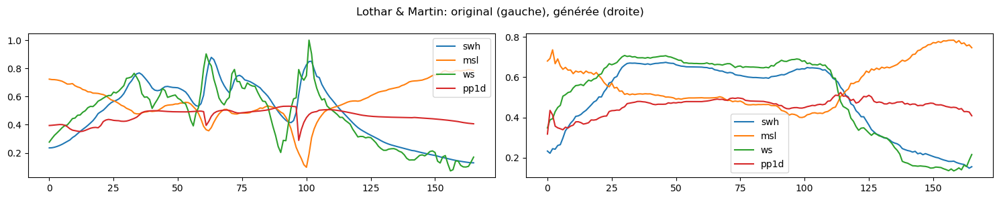

In [18]:
CHOICE_SAMPLES = lm_samples
VARIABLES = df_wo_nan.columns[1:]

nb_samples = len(CHOICE_SAMPLES)
padded_samples = [np.pad(t, ((max_length - len(t), 0), (0, 0))) for t in CHOICE_SAMPLES]
z_storm_run = autoencoder.encoder.predict(np.array(padded_samples))

fig, axs = plt.subplots(nb_samples, 2, figsize=(15,3 * nb_samples))

if nb_samples > 1:
    for i in range(nb_samples):
        # Encode/Decode data from input windows
        encoded_poi = z_storm_run[i]
        real_data = CHOICE_SAMPLES[i]
        
        latent_space_point = np.array([encoded_poi])
        decoded_data = autoencoder.decoder.predict(latent_space_point)
        # Remove padding
        decoded_data = decoded_data[:, decoded_data.shape[1] - len(real_data):, :]
        # Plot original/encoded/decoded data
        axs[i][0].plot(real_data)
        axs[i][1].plot(decoded_data[0])
        
        axs[i][0].legend(VARIABLES)
        axs[i][1].legend(VARIABLES)
else:
    # Encode/Decode data from input windows
    encoded_poi = z_storm_run[0]
    real_data = CHOICE_SAMPLES[0]
    
    latent_space_point = np.array([encoded_poi])
    decoded_data = autoencoder.decoder.predict(latent_space_point)
    # Remove padding
    decoded_data = decoded_data[:, decoded_data.shape[1] - len(real_data):, :]
    # Plot original/encoded/decoded data
    axs[0].plot(real_data)
    axs[1].plot(decoded_data[0])
    
    axs[0].legend(VARIABLES)
    axs[1].legend(VARIABLES)


fig.suptitle(f"Lothar & Martin: original (gauche), générée (droite)")
fig.tight_layout()
plt.show()

/home/hervy-b/miniconda3/envs/timeseries-clustering/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/hervy-b/miniconda3/envs/timeseries-clustering/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


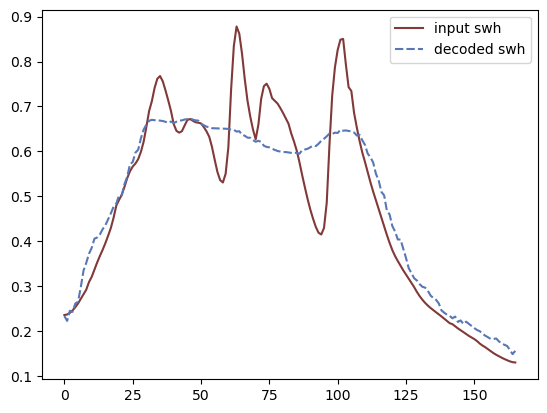

In [22]:
import matplotlib.colors as mcolors
import seaborn as sns
from cmcrameri import cm

COLORS = [mcolors.to_hex(cm.managua(i)) for i in np.linspace(0, 3, 9)]

plot_swh_data = {
    "input swh": real_data[:,0],
    "decoded swh": decoded_data[0][:,0] 
}
swh_df = pd.DataFrame(plot_swh_data)
sns.lineplot(swh_df, palette=[COLORS[1], COLORS[2]])
plt.savefig("FIGS/decoded_swh.pdf", dpi=300, bbox_inches='tight')

In [20]:
# Reshape to 2D array
final_data = z_run.reshape(z_run.shape[0], z_run.shape[1] * z_run.shape[2])

# Normalize of features between 0,1
min_per_fea = np.min(final_data, axis=(0, 1))
max_per_fea = np.max(final_data, axis=(0, 1))

normalized_diff = (final_data - min_per_fea) / (max_per_fea - min_per_fea)
print(normalized_diff.shape)

(1237, 144)


In [21]:
from sklearn.decomposition import PCA, FastICA
#import umap

DECOMPOSITION_METHOD = "PCA"

if DECOMPOSITION_METHOD == "PCA":
    N_COMPONENTS = 5
    pca = PCA(n_components=N_COMPONENTS).fit(normalized_diff)
    print(f"Explained variance ratio: {round(np.sum(pca.explained_variance_ratio_)*100)}%")
    reduced_data = pca.transform(normalized_diff)
elif DECOMPOSITION_METHOD == "FastICA":
    N_COMPONENTS = 2
    ica = FastICA(n_components=N_COMPONENTS, whiten='unit-variance')
    reduced_data = ica.fit_transform(normalized_diff)
    #reduced_data = ica.transform(normalized_diff)
    # Determine the number of components to use using the explained variance criterion
    explained_variance = np.var(reduced_data, axis=0)
    explained_variance_ratio = explained_variance / np.sum(explained_variance)
    print(f"Explained variance ratio: {explained_variance_ratio}")
    n_components = np.argmax(np.cumsum(explained_variance_ratio) >= 0.95) + 1
elif DECOMPOSITION_METHOD == "UMAP":
    N_COMPONENTS = 2
    reduced_data = umap.UMAP(random_state=42).fit_transform(normalized_diff) #produces 2-dimensions embedding
else:
    print("Please provide valid Sklearn decomposition algorithm")


Explained variance ratio: 83%


In [22]:
from sklearn import metrics
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
ch_score = []
db_score = []
sh_score = []
clusters = range(2, 12)
for k in clusters:
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(reduced_data)
    sse.append(kmeans.inertia_)
    ch_score.append(metrics.calinski_harabasz_score(reduced_data, kmeans.labels_))
    db_score.append(metrics.davies_bouldin_score(reduced_data, kmeans.labels_))
    sh_score.append(metrics.silhouette_score(reduced_data, kmeans.labels_))

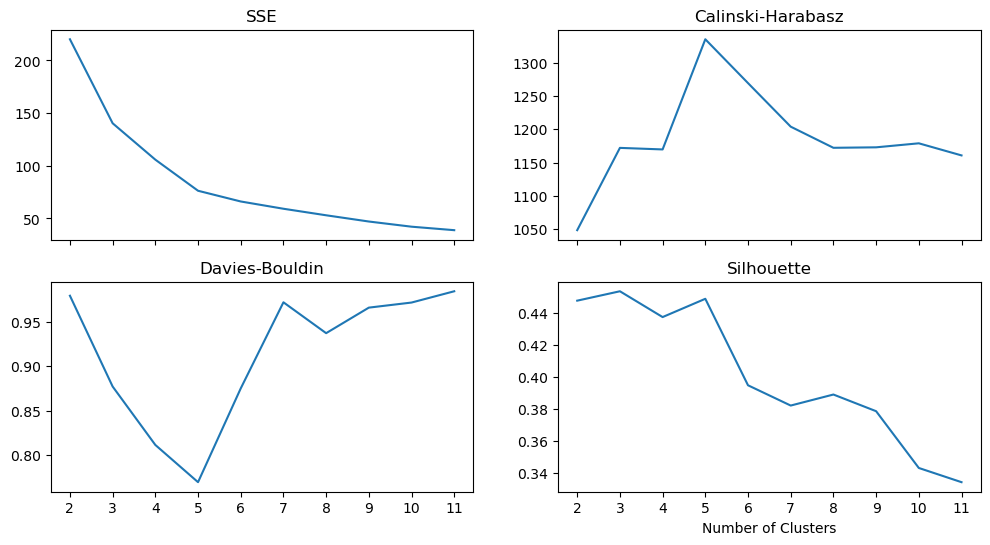

In [23]:
fig, axes = plt.subplots(nrows=2, ncols=2, sharex=True,
                                    figsize=(12, 6))

axes[0][0].plot(clusters, sse)
axes[0][0].set_title("SSE")
axes[0][1].plot(clusters, ch_score)
axes[0][1].set_title("Calinski-Harabasz")
axes[1][0].plot(clusters, db_score)
axes[1][0].set_title("Davies-Bouldin")
axes[1][1].plot(clusters, sh_score)
axes[1][1].set_title("Silhouette")
plt.xticks(clusters)
plt.xlabel("Number of Clusters")
plt.show()

In [24]:
import timeit
import pickle

# Choose N clusters
N_CLUSTER = 4

kmeans_kwargs = {
    "init": "k-means++",
    "n_init": 20,
    "max_iter": 50,
    "random_state": 42,
}

scores = {
    "SSE": [],
    "calinski" : [],
    "davies": []
}

KM_TRAINED = False
KM_MODEL_FILEPATH = "./model_dir/kmeans_cae_4c.pkl"

if KM_TRAINED:
    kmeans = KMeans.from_hdf5(KM_MODEL_FILEPATH)
    result = kmeans.labels_
else:
    start = timeit.default_timer()
    kmeans = KMeans(n_clusters=N_CLUSTER, **kmeans_kwargs)
    clustering_result = kmeans.fit_predict(reduced_data)
    scores["SSE"].append(kmeans.inertia_)
    scores["calinski"].append(metrics.calinski_harabasz_score(reduced_data, kmeans.labels_))
    scores["davies"].append(metrics.davies_bouldin_score(reduced_data, kmeans.labels_))
    stop = timeit.default_timer()
    execution_time = stop - start
    if os.path.exists(KM_MODEL_FILEPATH):
        os.remove(KM_MODEL_FILEPATH)
    pickle.dump(kmeans, open(KM_MODEL_FILEPATH, 'wb'))
    print(f"Test with {N_CLUSTER} clusters. Execution time: {execution_time}")
    
print(f"Nombre d'itérations {kmeans.n_iter_}")
print(f'SSE moyenne {np.mean(scores["SSE"])}')
print(f'Calinski {np.mean(scores["calinski"])}')
print(f'Davies Bouldin {np.mean(scores["davies"])}')

Test with 4 clusters. Execution time: 0.05014827700142632
Nombre d'itérations 16
SSE moyenne 105.8411865234375
Calinski 1169.8635645600236
Davies Bouldin 0.8114621905291396


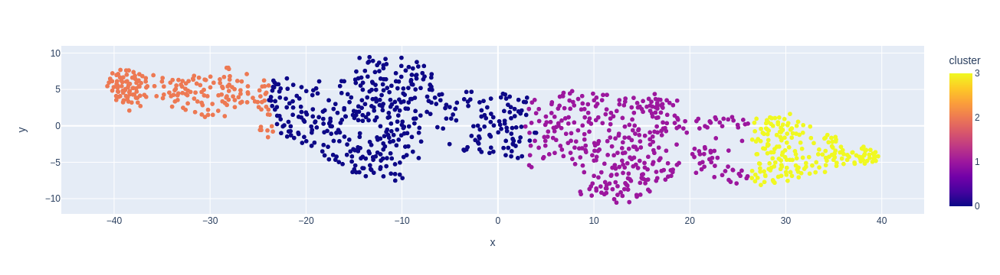

In [25]:
import plotly.graph_objs as go
import plotly.express as px
import plotly
from sklearn.manifold import TSNE

if N_COMPONENTS == 2:
    title = 'Clustering on PCA'
    df = pd.DataFrame(data=reduced_data, columns=["x", "y"])
    df["cluster"] = kmeans.labels_
    trace = px.scatter(
        df,
        x="x",
        y="y",
        color="cluster"
    )
else:
    df = pd.DataFrame(data=reduced_data, columns=[f"feat_{i}" for i in range(N_COMPONENTS)])
    title = 'tSNE on predicted data'
    tsne = TSNE(perplexity=80, min_grad_norm=1E-12, n_iter=1000).fit_transform(reduced_data)
    tsne_df = pd.DataFrame(data=tsne, columns=["x", "y"])
    tsne_df["cluster"] = kmeans.labels_
    df["cluster"] = kmeans.labels_
    trace = px.scatter(
        tsne_df,
        x="x",
        y="y",
        color="cluster"
    )
fig = go.Figure(data=trace)
plotly.offline.iplot(fig)

/home/hervy-b/miniconda3/envs/timeseries-clustering/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



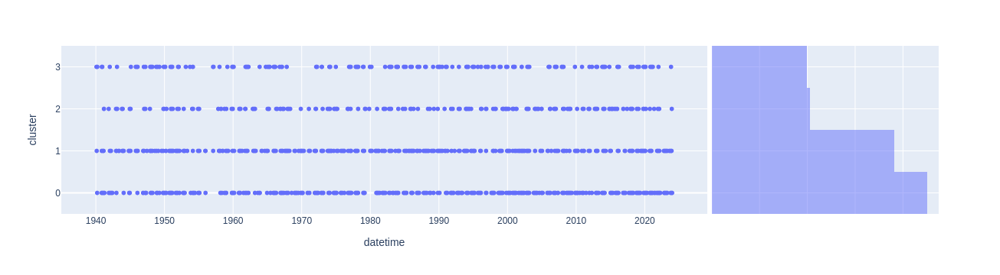

In [26]:
import plotly.express as px

plot_df = pd.DataFrame(data=zip(windows[:,0], clustering_result), columns=['datetime', 'cluster'])
fig = px.scatter(plot_df, x="datetime", y="cluster", marginal_y="histogram")
fig.show()

In [27]:
N_VARIABLES = len(VARIABLES)

x_data = [{k:[] for k in range(N_CLUSTER)} for v in range(N_VARIABLES)]

clusters_value = list(zip(timeseries, kmeans.labels_))
for y in range(N_CLUSTER):
    for t, c in clusters_value:
        if c == y:
            for v in range(N_VARIABLES):
                x_data[v][c] += list(t[:, v])

# Create array of cluster IDs corresponding to x values, cf. https://plotly.com/python/box-plots/
y_data = []
for c in range(N_CLUSTER):
    y_data += [c for v in x_data[0][c]]


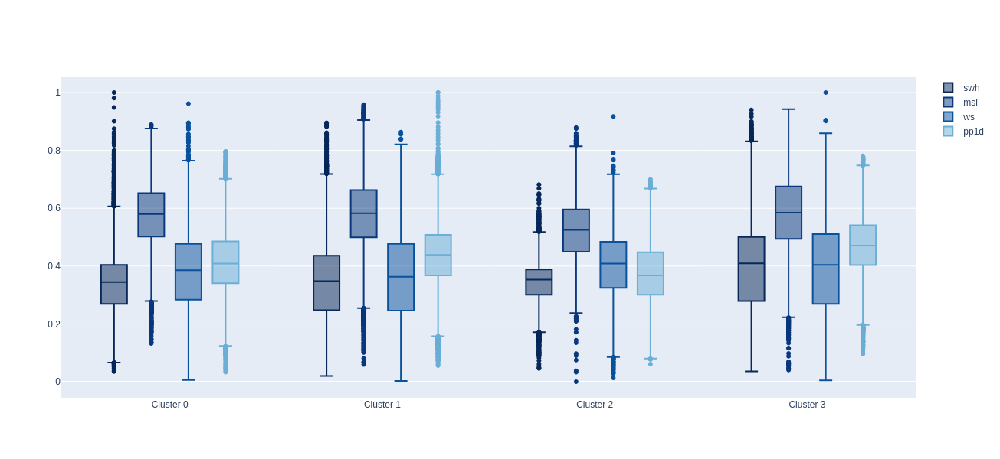

In [28]:
import plotly.graph_objects as go

fig = go.Figure()

marker_color_list = [
    'rgb(7,40,89)',
    'rgb(9,56,125)',
    'rgb(8,81,156)',
    'rgb(107,174,214)',
]

for v in range(N_VARIABLES):
    fig.add_trace(go.Box(
        x=y_data,
        y=sum([x for k, x in x_data[v].items()], []),
        name=VARIABLES[v],
        marker_color=marker_color_list[v]
    ))

fig.update_layout(
    boxmode='group',
    width=1200,
    height=600,
    xaxis = dict(
        tickmode = 'array',
        tickvals = [c for c in range(N_CLUSTER)],
        ticktext = ["Cluster " + str(c) for c in range(N_CLUSTER)]
    )
)
fig.show()

In [29]:
STORM = "Xynthia"
# Get index of corresponding windows in initial list
def get_storm_cluster(storm_name: str):
    selected_windows = []
    for idx, window in enumerate(windows):
        check = (window[0].date() >= storm_dates[storm_name][0].date() and window[1].date() <= storm_dates[storm_name][1].date())
        if check:
            selected_windows.append((idx, window))
    return (selected_windows, df.iloc[selected_windows[0][0]]['cluster'])

print(get_storm_cluster(STORM))

([(1001, array([Timestamp('2010-02-28 02:00:00'), Timestamp('2010-03-01 07:00:00')],
      dtype=object))], 0.0)


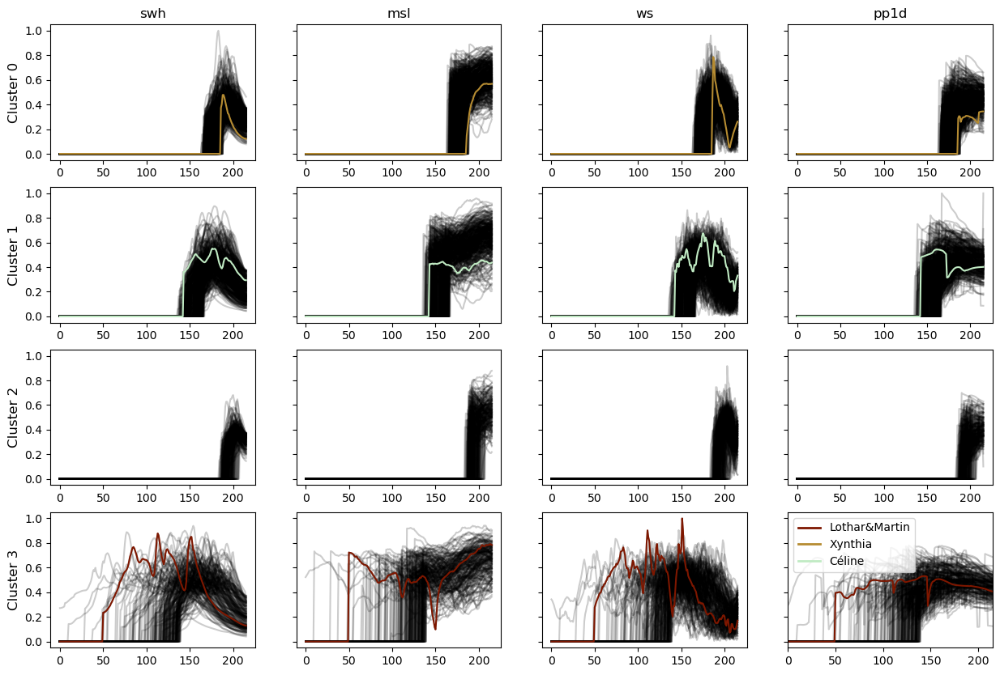

In [30]:
import seaborn as sns
from matplotlib.colors import ListedColormap
from matplotlib.lines import Line2D
from cmcrameri import cm

sz = full_train_data.shape[1]
fig, axs = plt.subplots(N_CLUSTER, N_VARIABLES, figsize=(15, 10), sharey=True)

#cmap = ListedColormap(sns.color_palette(palette='rocket', n_colors=3).as_hex()).colors
## Define blindness-compliant colors
colors = cm.roma(np.linspace(0, 1, 9))

for yi in range(N_CLUSTER):
    ## Get only series from the corresponding cluster using numpy indexing/slicing (`result` being a vector of cluster numbers)
    for xx in full_train_data[clustering_result == yi]:
        for d in range(N_VARIABLES):
            axs[yi][d].plot(xx[:, d], "k-", alpha=.2)
            #axs[yi][d].plot(kmeans.cluster_centers_[yi], "r-")

## Plot known storms

for s_index in range(3):
    storm_name = list(storm_dates.keys())[s_index]
    storm_infos = get_storm_cluster(storm_name)
    storm_cluster = int(storm_infos[1])
    storm_index = storm_infos[0][0][0]
    poi_ref = timeseries[storm_index].tolist()
    padded_storm_data = np.pad(poi_ref, ((max_length - len(poi_ref), 0), (0, 0)))
    
    for d in range(N_VARIABLES):
        axs[storm_cluster][d].plot(padded_storm_data[:, d], color=colors[2*s_index], alpha=1, label=storm_name)

# Display titles for columns and rows
cols = VARIABLES_TO_KEEP
rows = [f'Cluster {k}' for k in range(N_CLUSTER)]
for ax, col in zip(axs[0], cols):
    ax.set_title(col)

for ax, row in zip(axs[:,0], rows):
    ax.set_ylabel(row, rotation=90, size='large')

# Custom legend for article guidelines
legend_elements = [Line2D([0], [0], color=colors[0], lw=2, label='Line'),
                   Line2D([0], [0], color=colors[2], lw=2, label='Line'),
                   Line2D([0], [0], color=colors[4], lw=2, label='Line'),]
plt.legend(legend_elements, ['Lothar&Martin', 'Xynthia', 'Céline'])
    
plt.margins(0,0)
plt.savefig("FIGS/AE_KM_clusters.pdf", dpi=300, bbox_inches='tight')

In [31]:
cluster_infos = {}

clusters_value = list(zip(raw_timeseries, kmeans.labels_))

for c in range(N_CLUSTER):
    cluster_infos[c] = {}
    cluster_items = list(map(lambda x: x[0], filter(lambda x: (x[1] == c), clusters_value)))
    for j in range(N_VARIABLES):
        series = [list(c[:, j]) for c in cluster_items]
        max_series_var = [max(sv) for sv in series]
        min_series_var = [min(sv) for sv in series]
        avg_series_var = [np.mean(sv) for sv in series]
        cluster_infos[c][j] = (min(min_series_var), np.mean(avg_series_var), max(max_series_var))

print(cluster_infos)

{0: {0: (0.41377782821655273, 2.6657395235029644, 7.513339042663574), 1: (96990.5390625, 100944.09675500228, 103719.8203125), 2: (0.17753943800926208, 10.29963448987233, 25.956510543823242), 3: (2.9872817993164062, 11.428630852529984, 20.123401641845703)}, 1: {0: (0.2976646939665435, 2.7095457716374893, 6.741180419921875), 1: (96346.75, 100954.06938189706, 104333.8203125), 2: (0.08521439880132675, 9.730483741313817, 23.309829711914062), 3: (3.478574752807617, 12.10477338216458, 24.692726135253906)}, 2: {0: (0.4932999610900879, 2.6925289536600623, 5.1695709228515625), 1: (95818.015625, 100497.74800667756, 103625.6484375), 2: (0.35646915435791016, 10.933474253031633, 24.76410484313965), 3: (3.603367805480957, 10.672249009847363, 17.945087432861328)}, 3: {0: (0.4135141372680664, 3.0204735824888815, 7.070549011230469), 1: (96178.78125, 100977.18296273086, 104190.265625), 2: (0.13629671931266785, 10.39312903752305, 26.99989128112793), 3: (4.392354965209961, 12.736337770040487, 19.7761440277

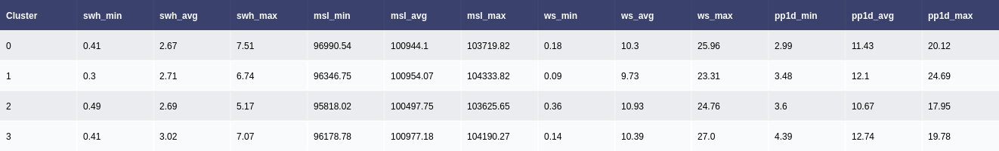

In [32]:
import plotly.figure_factory as ff

data_matrix = [['Cluster', 'swh_min', 'swh_avg', 'swh_max', 'msl_min', 'msl_avg', 'msl_max', 'ws_min', 'ws_avg', 'ws_max', 'pp1d_min', 'pp1d_avg', 'pp1d_max']]
for i in range(N_CLUSTER):
    row = [i]
    for j in range(N_VARIABLES):
        var_row = [round(v, 2) for v in cluster_infos[i][j]]
        row += var_row
    data_matrix.append(row)

fig = ff.create_table(data_matrix)
fig.show()

## Clustering IRSN database storm records

- URL : https://bddtsh.irsn.fr/
- Check cluster number for storm events/submersion listed by french consortium over the past 100 years

### Read input csv file

- Drop rows with NaN values
- Get datetime from columns Year, Month, Day
- Drop events before 1940

In [33]:
bddtsh = pd.read_csv("DATA/BDD-TSH-IRSN.csv", sep=";")
bddtsh = bddtsh.dropna()
bddtsh = bddtsh[bddtsh.Annee > 1940]
bddtsh['date'] = pd.to_datetime(dict(year=bddtsh.Annee, month=bddtsh.Mois, day=bddtsh.Jour))
print(bddtsh.head())
print(f"{len(bddtsh)} remaining events at this stage")

    Jour  Mois  Annee       date
34  16.0   2.0   1941 1941-02-16
35  12.0   1.0   1943 1943-01-12
36   9.0  12.0   1946 1946-12-09
37  28.0  12.0   1947 1947-12-28
38  27.0   1.0   1948 1948-01-27
75 remaining events at this stage


### Find corresponding timeseries and cluster

- find the series that contains each event's datetime
- find corresponding cluster when possible

In [34]:
# For each storm, get corresponding window if it exists and the cluster number
series_numbers = []
cluster_numbers = []
for storm_date in bddtsh['date']:
    # Get index of corresponding windows in initial list
    selected_windows = []
    for idx, window in enumerate(windows):
        check = (window[0].date() <= storm_date.date() and window[1].date() >= storm_date.date())
        if check:
            selected_windows.append((idx, window))
    if len(selected_windows) >= 1:
        series_numbers.append(int(selected_windows[0][0]))
        cluster = df.iloc[selected_windows[0][0]]["cluster"]
        cluster_numbers.append(int(cluster))
    else:
        series_numbers.append(None)
        cluster_numbers.append(None)
        
bddtsh["window"] = series_numbers
bddtsh["cluster"] = cluster_numbers
bddtsh = bddtsh.dropna()
print(f"{len(bddtsh)} remaining events at this stage")

62 remaining events at this stage


### Event distribution within clusters

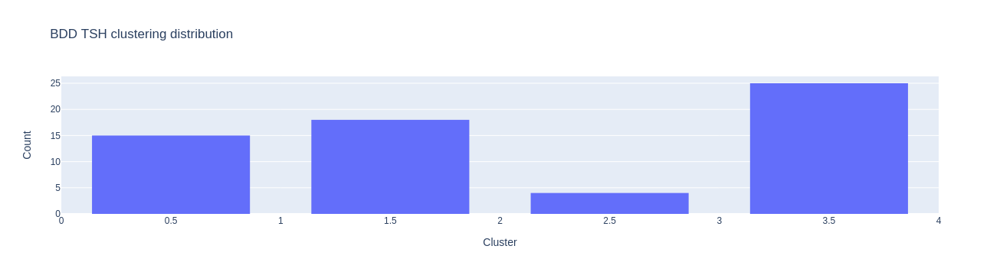

In [35]:
import plotly.graph_objects as go

# Get non Nan rows
bddtsh_wo_nan = bddtsh.dropna()
# Plot histogram
fig = go.Figure(
    go.Histogram(
    x=bddtsh_wo_nan['cluster'],
    xbins=dict( # bins used for histogram
        start=0,
        end=10,
        size=1
    ),
    opacity=1
))
fig.update_layout(
    title_text='BDD TSH clustering distribution', # title of plot
    xaxis_title_text='Cluster', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

/home/hervy-b/miniconda3/envs/timeseries-clustering/lib/python3.11/site-packages/plotly/express/_core.py:1992: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/home/hervy-b/miniconda3/envs/timeseries-clustering/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



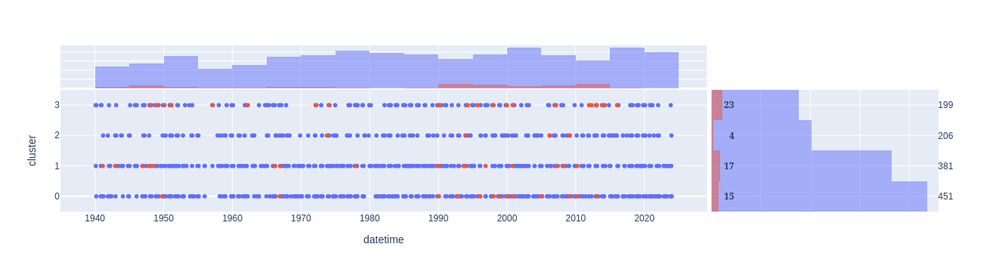

In [36]:
import plotly.express as px
import plotly.io as pio

plot_df = pd.DataFrame(data=zip(windows[:,0], clustering_result), columns=['datetime', 'cluster'])
# Append 1 if series is in BDDTSH, 0 otherwise
plot_df['bddtsh'] = plot_df.index.isin(bddtsh['window'].values).astype(str)
fig = px.scatter(plot_df, x="datetime", y="cluster", color="bddtsh", marginal_x="histogram", marginal_y="histogram")

fig.update_layout(showlegend=False)
# Add annotations to histograms
hist_y = plot_df['cluster'].value_counts()
hist_y_true = plot_df[plot_df['bddtsh'] == 'True']['cluster'].value_counts()
for i, (cluster, count) in enumerate(hist_y.items()):
    fig.add_annotation(x=1.02, y=cluster, text=str(count), showarrow=False, xref='paper', yref='y')
for i, (cluster, count) in enumerate(hist_y_true.items()):
    fig.add_annotation(x=0.77, y=cluster, text=f'<b>{count}</b>', showarrow=False, xref='paper', yref='y', font=dict(family='Bold'))

pio.write_image(fig, "FIGS/AE_KM_cluster_time_bddtsh.png", width=1.5*600, height=0.75*600, scale=1)
fig.show()


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
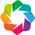

:Chord   [source,target]   (value)

In [37]:
import holoviews as hv
from holoviews import opts, dim

hv.extension('bokeh')
hv.output(size=200)

nodes = bddtsh_wo_nan
groups = {}

# Construct links
for ind in bddtsh_wo_nan.index:
    if bddtsh_wo_nan['cluster'][ind] in groups.keys():
        groups[bddtsh_wo_nan['cluster'][ind]].append(bddtsh_wo_nan['date'][ind])
    else:
        groups[bddtsh_wo_nan['cluster'][ind]] = [bddtsh_wo_nan['date'][ind]]

links = []
for g in groups.keys():
    for d in groups[g][:]:
        links.extend([[d, d2, 1] for d2 in groups[g] if d != d2])
        groups[g].remove(d)

links = pd.DataFrame(links, columns=['source', 'target', 'value'])
nodes = hv.Dataset(nodes, 'date', 'cluster')
chord = hv.Chord((links, nodes))
chord.opts(
    opts.Chord(cmap='Category20', edge_cmap='Category20', labels='date', node_color=dim('cluster').str()))
